## 导入库

In [ ]:
# 基础数据处理和可视化
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']

# 机器学习相关
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.datasets import fetch_california_housing

# 深度学习相关
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout

# XGBoost相关
import xgboost as xgb

# 超参数优化
import optuna
from optuna.samplers import TPESampler

# 其他工具
from datetime import datetime, timedelta
import os
import joblib

# 自定义模块
from plot import *
from process_read import *
from calculate import *

def pearson_correlation_coefficient(y_true, y_pred):
    """计算皮尔逊相关系数"""
    # 使用 numpy 的 corrcoef 函数
    return np.corrcoef(y_true, y_pred)[0, 1]


## 读取数据

### 读取预测气象数据

In [14]:
result = collect_filename(r'E:\USTC_New_Past\USTC_Now_Predict','WP3_32.75N-118.30E_')

file_paths = result
# print(file_paths)

dfs = [pd.read_csv(file, header=0,names=['time','height','predicted_speed','predicted_direction','predicted_temperature','predicted_humidity',
        'predicted_pressure']) for file in file_paths]

# 初始化一个空的 DataFrame 来存储第1天的数据
first_day_data = pd.DataFrame()

# 遍历每个 DataFrame 并筛选第1天的数据
for df in dfs:
    # 将 'time' 列转换为 datetime 类型
    df['time'] = pd.to_datetime(df['time'])

    # 找到最小的时间点作为第一天的开始
    min_time = df['time'].min()

    first_day_start = min_time
    first_day_end  = first_day_start + timedelta(days=1)

    first_day_df =  df[(df['time'] >= first_day_start) & (df['time'] < first_day_end)]
    first_day_data = pd.concat([first_day_data, first_day_df], ignore_index=True)

# 将时间列转换为datetime类型
first_day_data['time'] = pd.to_datetime(first_day_data['time'], errors='coerce')

# 获取所有唯一的高度值
heights = first_day_data['height'].unique()

# 创建一个以时间为索引的新DataFrame
merged_data = pd.DataFrame()
merged_data['time'] = first_day_data['time'].unique()
merged_data.set_index('time', inplace=True)

# 对每个高度，提取相应的数据并添加到新DataFrame中
for height in heights:
    # 筛选特定高度的数据
    height_data = first_day_data[first_day_data['height'] == height].copy()
    height_data.set_index('time', inplace=True)
    
    # 添加带有高度后缀的列
    merged_data[f'wind_speed_{int(height)}m'] = height_data['predicted_speed']
    merged_data[f'wind_direction_{int(height)}m'] = height_data['predicted_direction']
    merged_data[f'temperature_{int(height)}m'] = height_data['predicted_temperature']
    merged_data[f'humidity_{int(height)}m'] = height_data['predicted_humidity']
    merged_data[f'pressure_{int(height)}m'] = height_data['predicted_pressure']

# 重置索引，使时间成为一个列
merged_data.reset_index(inplace=True)

# 按时间排序
merged_data.sort_values('time', inplace=True)

# 显示结果
merged_data

,time,wind_speed_10m,wind_direction_10m,temperature_10m,humidity_10m,pressure_10m,wind_speed_30m,wind_direction_30m,temperature_30m,humidity_30m,...,wind_speed_110m,wind_direction_110m,temperature_110m,humidity_110m,pressure_110m,wind_speed_130m,wind_direction_130m,temperature_130m,humidity_130m,pressure_130m
0,2023-09-02 00:00:00,2.028342,194.240174,19.981683,87.913120,999.013750,3.069247,188.575721,21.643854,78.912940,...,5.852839,182.879944,23.454095,61.274160,987.617813,6.208806,184.801195,23.508691,60.847183,985.361406
1,2023-09-02 00:15:00,2.018772,193.645251,19.825372,88.047530,998.824141,3.065634,188.692640,21.555444,78.547320,...,5.734138,185.444694,23.459619,60.879433,987.427656,6.078076,187.341916,23.504816,60.550170,985.171641
2,2023-09-02 00:30:00,2.023280,193.364708,19.709222,88.000760,998.702500,3.076379,189.128734,21.501581,78.045074,...,5.651356,187.602706,23.435144,60.956230,987.305781,5.999059,189.490830,23.486658,60.469510,985.049922
3,2023-09-02 00:45:00,2.033148,193.671985,19.618555,87.799510,998.607344,3.092194,190.079947,21.460718,77.499580,...,5.590908,189.649017,23.384271,61.227436,987.210234,5.954360,191.496542,23.455133,60.413395,984.954141
4,2023-09-02 01:00:00,2.042211,194.728806,19.545496,87.505840,998.522656,3.104859,191.611549,21.425836,77.012505,...,5.549039,191.652503,23.324609,61.399960,987.124688,5.933762,193.423284,23.415887,60.257774,984.868438
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53467,2025-03-11 22:45:00,2.193293,167.385452,14.381372,80.247665,1003.810234,2.838065,163.482941,14.358087,79.782950,...,5.231645,141.871936,14.351892,78.261170,992.010703,6.028798,136.851118,14.366998,77.962780,989.667891
53468,2025-03-11 23:00:00,2.184029,161.481122,14.316370,80.780940,1003.748047,2.839924,158.981874,14.296960,80.272400,...,5.229311,138.883864,14.332452,78.416410,991.947500,6.015238,133.872036,14.355798,78.081710,989.604687
53469,2025-03-11 23:15:00,2.177837,153.538650,14.245599,81.304820,1003.721875,2.844268,152.352383,14.238763,80.696180,...,5.263196,134.201305,14.336237,78.493190,991.919922,6.047996,129.402278,14.368890,78.144455,989.577109
53470,2025-03-11 23:30:00,2.241461,147.824254,14.208032,81.560280,1003.608984,2.914932,146.991600,14.204736,80.924320,...,5.378893,130.487595,14.345758,78.617620,991.807656,6.171242,125.985571,14.381097,78.294420,989.465312


### 读取实测功率数据

In [ ]:
file_path = r'E:/Power_Pre_Model/actual_value/安徽.鲁山场发电功率实测值.txt'

# 读取数据（假设数据分隔符为空格）
df = pd.read_csv(
    file_path,
    header=0,
    low_memory=False,
    names=["time", "power"]  # 直接指定列名
)
df['time'] = pd.to_datetime((df['time']), errors='coerce')
df.set_index('time', inplace=True)

#按15分钟重采样
mask = (df.index.minute%15 ==0) & (df.index.second == 0)
df = df.loc[mask]

df
# # 按年月分别绘制散点图
# years = df.index.year.unique()
# months = range(1, 13)  # 1-12月

# for year in years:
#     for month in months:
#         data = df[(df.index.year == year) & (df.index.month == month)]
#         if not data.empty:  # 只绘制有数据的月份
#             # 计算该月数据点数量
#             data_points = len(data)
            
#             plt.figure(figsize=(15, 10))
#             plt.scatter(data.index, data['power'], alpha=0.5, s=10, color='blue')
            
#             plt.xlabel('时间')
#             plt.ylabel('功率 (kW)')
#             plt.title(f'鲁山场发电功率 - {year}年{month}月 (数据点数: {data_points})')
#             plt.xticks(rotation=45)
#             plt.grid(True, linestyle='--', alpha=0.7)
            
#             # 在图表右上角添加数据点信息
#             plt.text(0.95, 0.95, f'数据点数量: {data_points}', 
#                     transform=plt.gca().transAxes,
#                     verticalalignment='top',
#                     horizontalalignment='right',
#                     bbox=dict(facecolor='white', alpha=0.8))
            
#             plt.tight_layout()
#             save_dir = 'power_act'
#             os.makedirs(save_dir, exist_ok=True)
#             plt.savefig(os.path.join(save_dir, f'鲁山场发电功率_{year}年{month}月散点图.png'), dpi=300, bbox_inches='tight')
#             # plt.show()
            
#             # 打印每月数据点数量
#             print(f'{year}年{month}月的数据点数量: {data_points}')



,power
time,
2023-09-01 00:00:00,7.168572
2023-09-01 00:15:00,5.326182
2023-09-01 00:30:00,4.823712
2023-09-01 00:45:00,4.019760
2023-09-01 01:00:00,6.398118
...,...
2024-11-01 23:00:00,13.064220
2024-11-01 23:15:00,11.255328
2024-11-01 23:30:00,9.647424


### 读取实测气象数据

In [16]:
file_path = r'E:\Power_Pre_Model\actual_value\AH_LS_WP_actual.txt'

# 读取数据（假设数据分隔符为空格）
df_ls = pd.read_csv(
    file_path,
    sep=',',
    encoding='utf-8',
    low_memory=False,
    header=0,
    usecols=[0,1,2],
    names=['time','height','wind_speed']
)
df_ls['time'] = pd.to_datetime((df_ls['time']), errors='coerce')
df_ls.set_index('time', inplace=True)

# 获取所有唯一的高度值
heights = df_ls['height'].unique()

# 创建一个新的DataFrame来存储合并后的数据
df_ls_merge = pd.DataFrame(index=df_ls.index.unique())

# 对每个高度，提取相应的风速数据并添加到新DataFrame中
for height in heights:
    # 筛选特定高度的数据
    height_data = df_ls[df_ls['height'] == height].copy()
    
    # 添加带有高度后缀的列
    df_ls_merge[f'wind_speed_{int(height)}m_act'] = height_data['wind_speed']

# 按时间排序
df_ls_merge.sort_index(inplace=True)

#按15分钟重采样
mask = (df_ls_merge.index.minute%15 ==0) & (df_ls_merge.index.second == 0)
df_ls_merge = df_ls_merge.loc[mask]

df_ls_merge

,wind_speed_0m_act,wind_speed_10m_act,wind_speed_30m_act,wind_speed_50m_act,wind_speed_70m_act
time,,,,,
2023-09-01 00:00:00,3.401,0.973,3.193,3.821,3.401
2023-09-01 00:15:00,3.304,0.681,1.779,2.559,3.304
2023-09-01 00:30:00,3.444,0.131,1.585,2.428,3.444
2023-09-01 00:45:00,3.140,0.442,1.998,2.838,3.140
2023-09-01 01:00:00,3.260,0.988,2.424,2.929,3.260
...,...,...,...,...,...
2024-11-01 23:00:00,-99.000,-99.000,-99.000,-99.000,-99.000
2024-11-01 23:15:00,-99.000,-99.000,-99.000,-99.000,-99.000
2024-11-01 23:30:00,-99.000,-99.000,-99.000,-99.000,-99.000


### 读取鲁山预测功率数据

2023年9月的数据点数量: 2591
2023年10月的数据点数量: 2976
2023年11月的数据点数量: 2880
2023年12月的数据点数量: 2976
2024年1月的数据点数量: 2976
2024年2月的数据点数量: 2784
2024年3月的数据点数量: 2976
2024年4月的数据点数量: 2880
2024年5月的数据点数量: 2976
2024年6月的数据点数量: 2880
2024年7月的数据点数量: 2976
2024年8月的数据点数量: 2976
2024年9月的数据点数量: 2496
2024年10月的数据点数量: 2976
2024年11月的数据点数量: 97


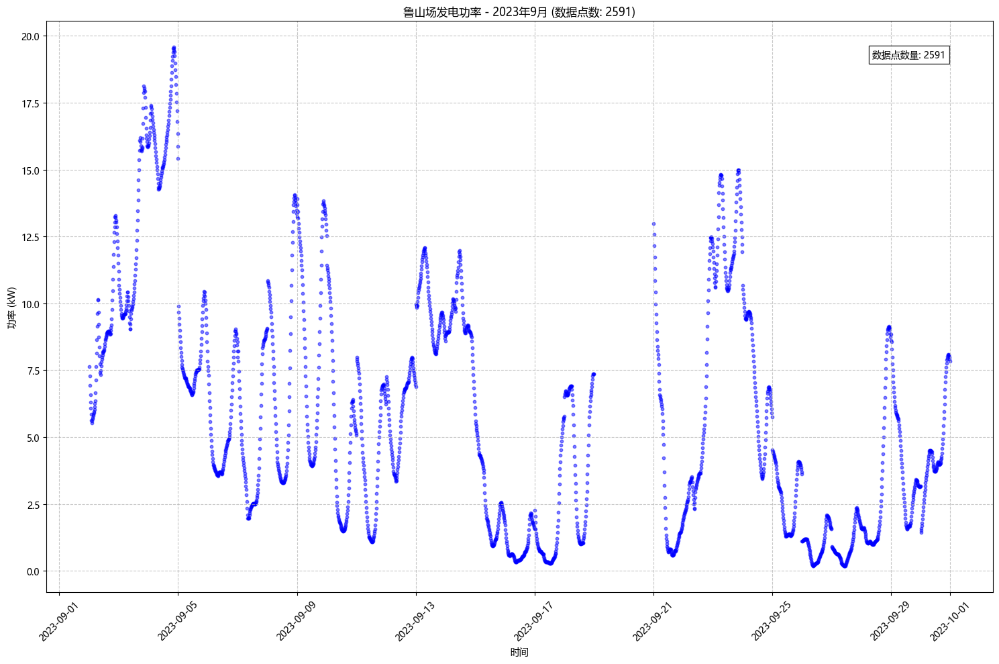

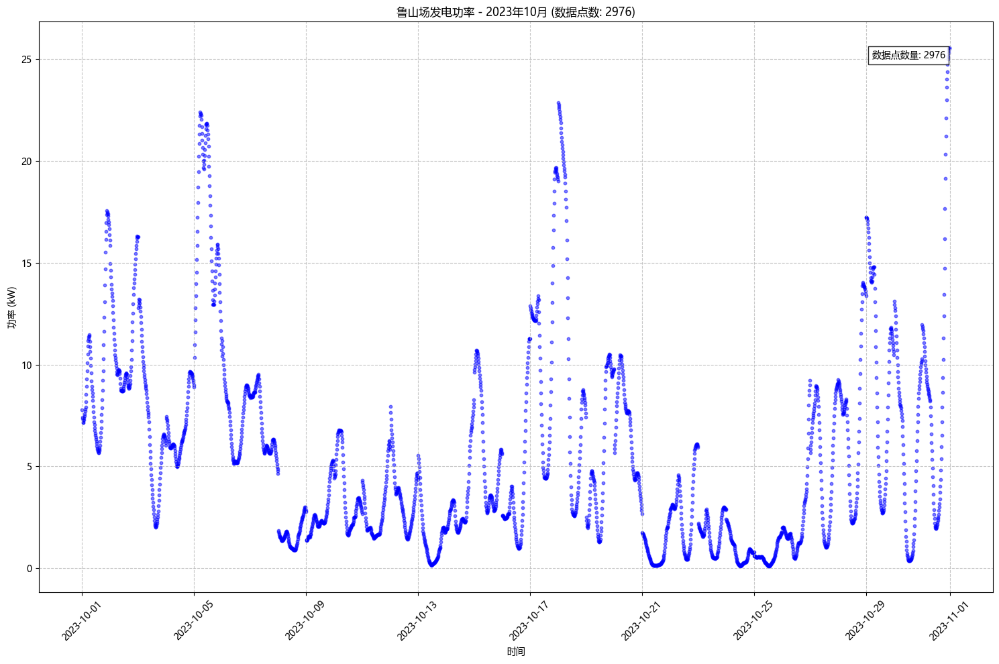

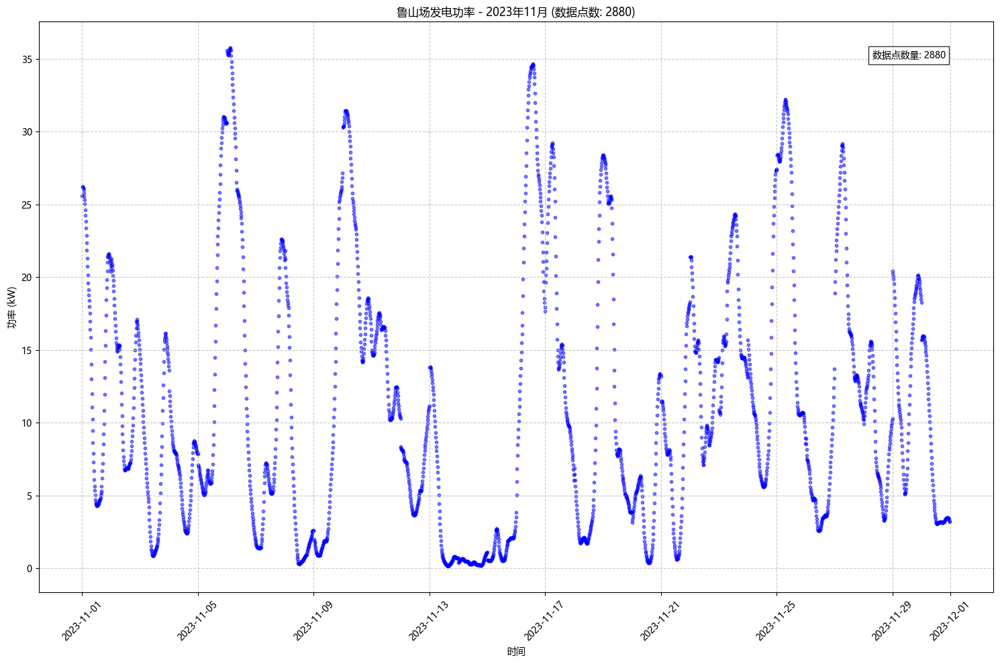

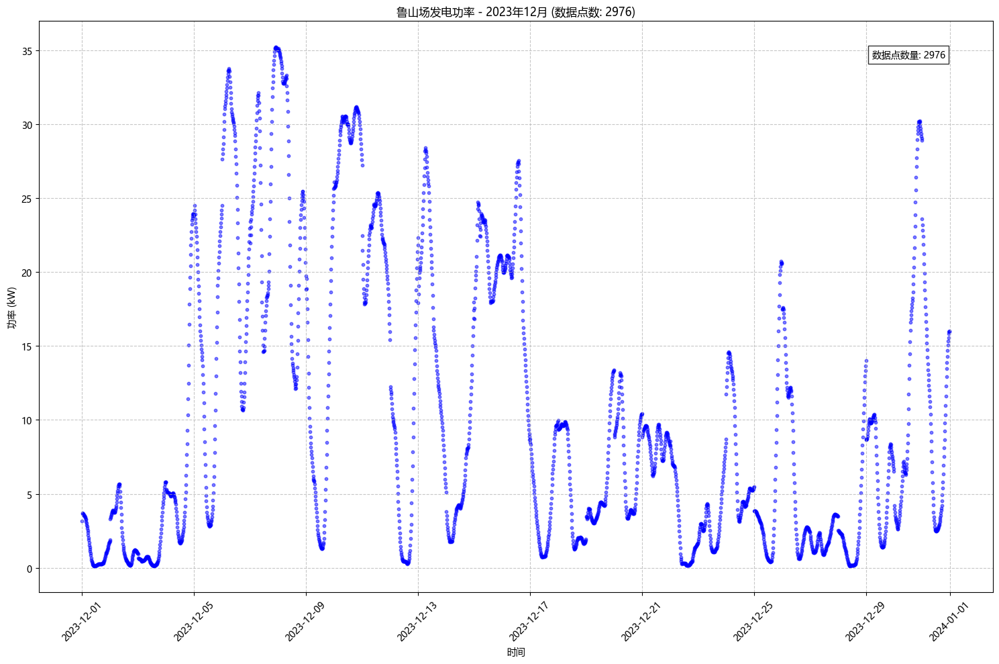

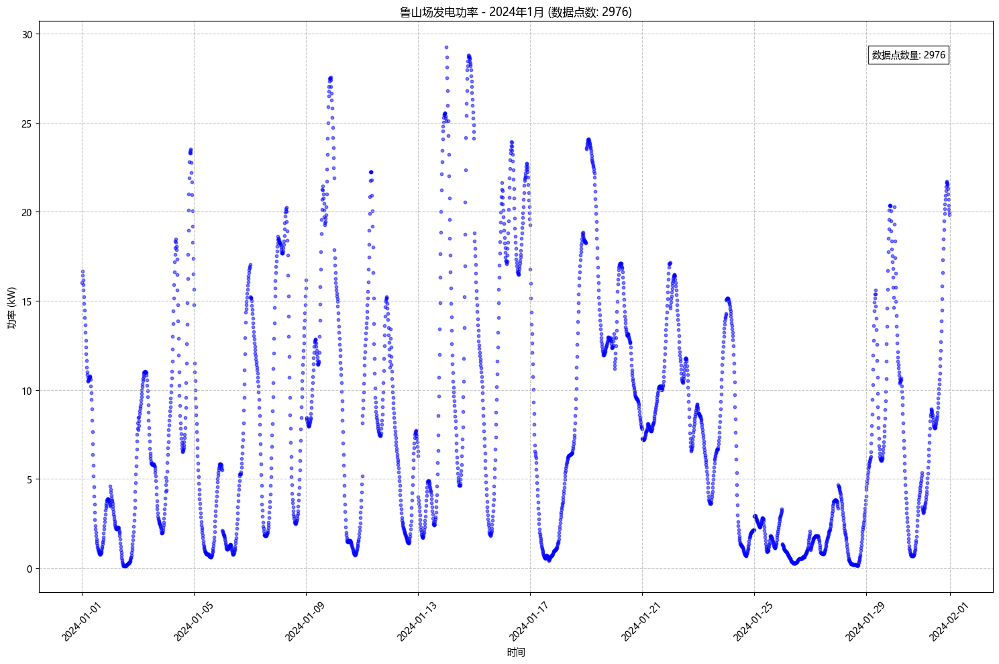

...

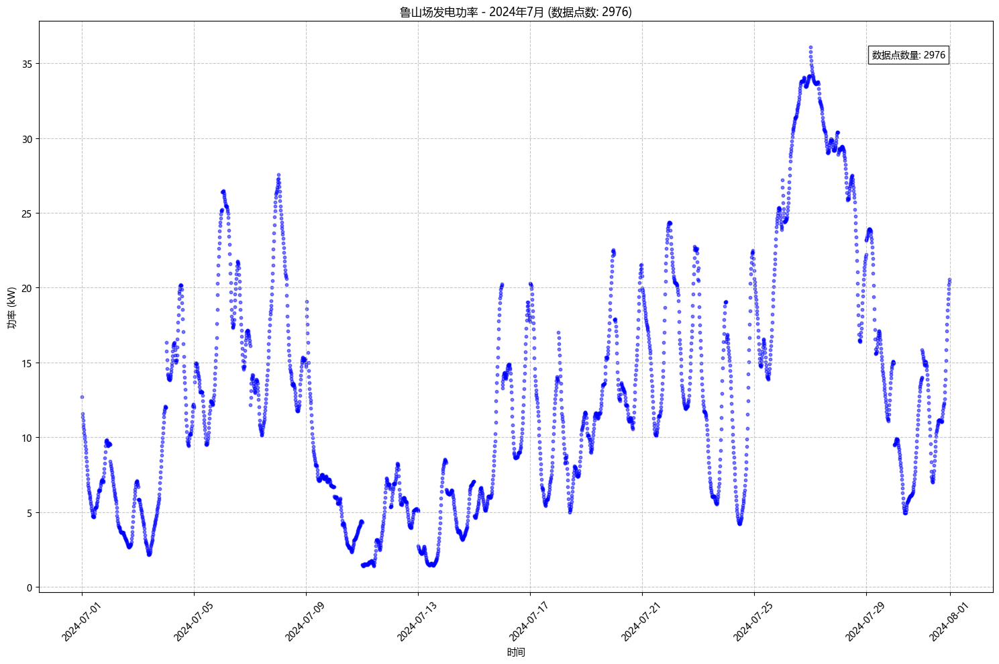

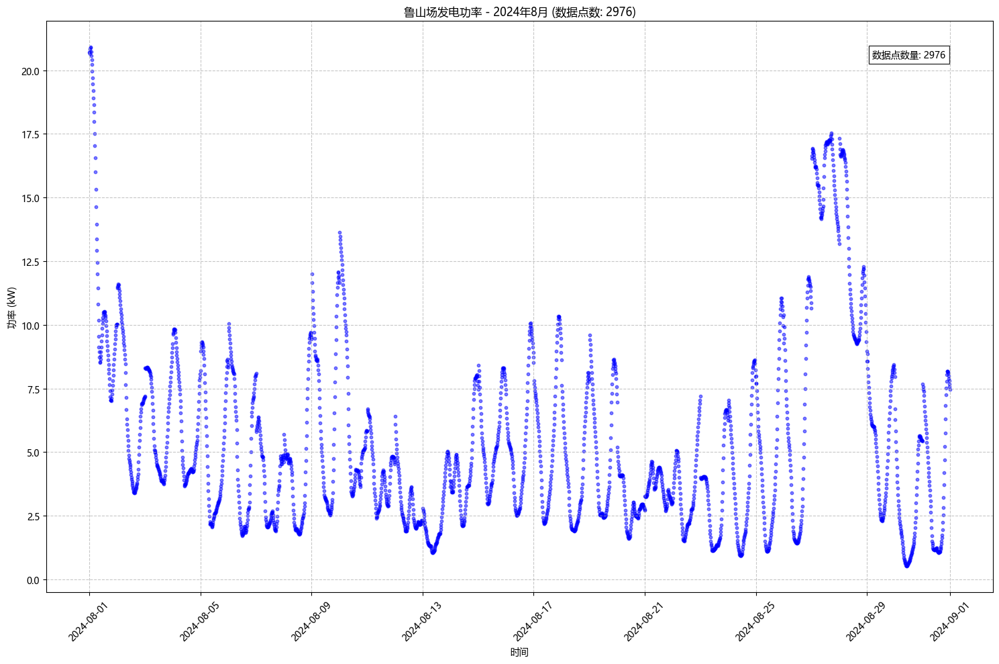

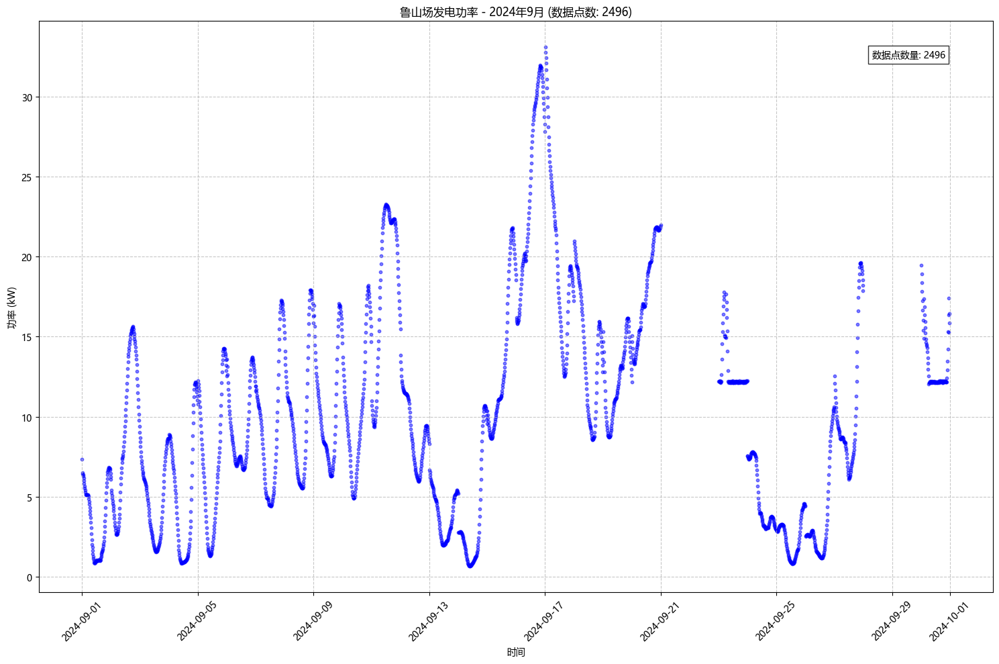

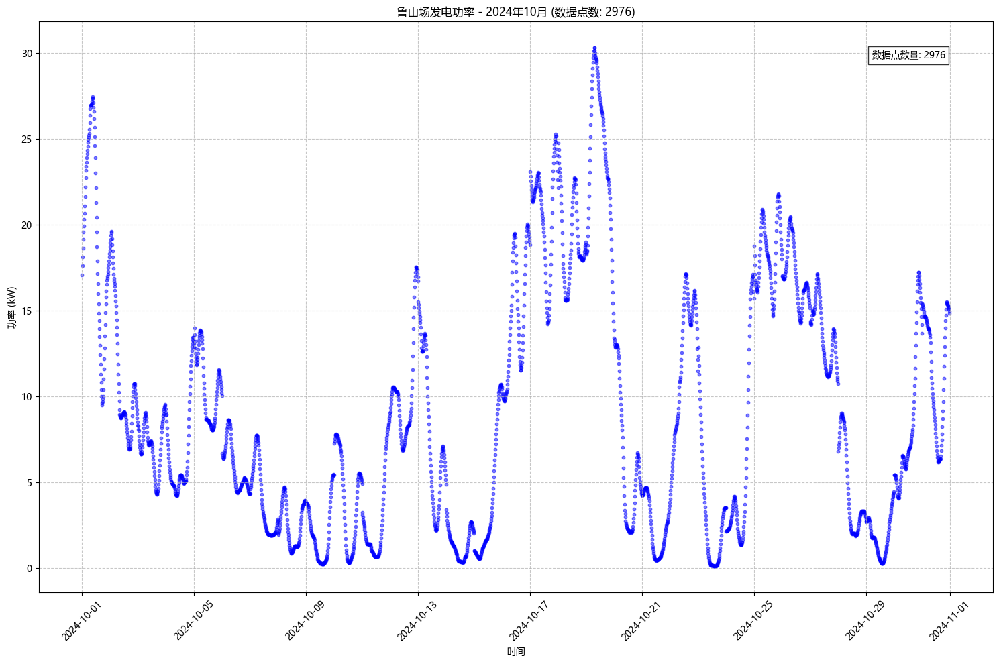

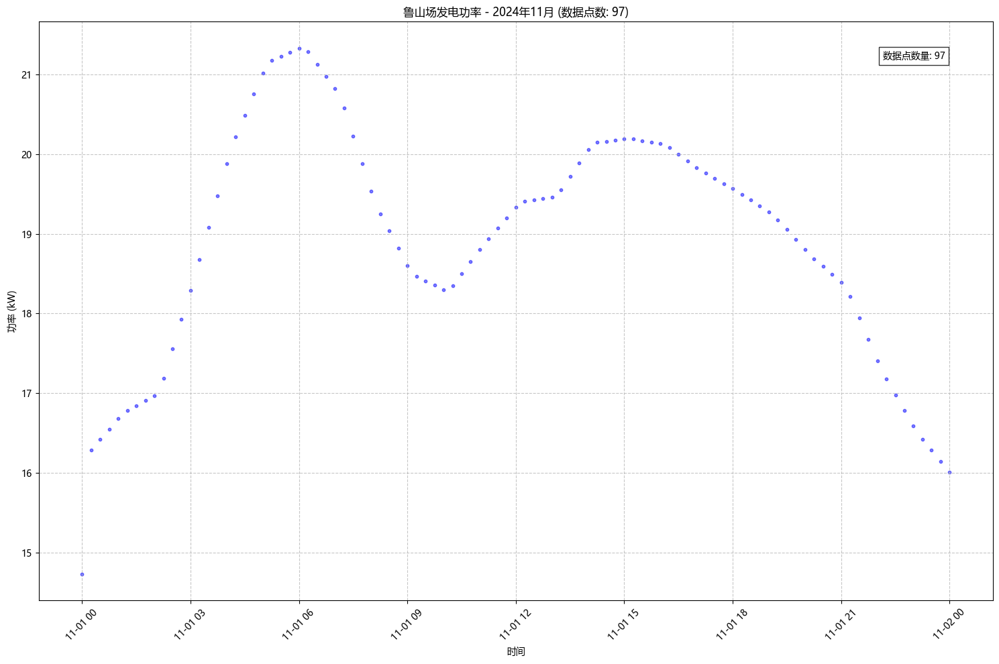

In [17]:
file_path = r'E:\Power_Pre_Model\actual_value\安徽.鲁山场短期功率预测.txt'

# 读取数据（假设数据分隔符为空格）
df_pre_ls = pd.read_csv(
    file_path,
    header=0,
    low_memory=False,
    usecols=[1,2],
    names=["time", "power_ls"]  # 直接指定列名
)
# 转换时间列并删除重复时间值
df_pre_ls['time'] = pd.to_datetime(df_pre_ls['time'], errors='coerce')
df_pre_ls = df_pre_ls.drop_duplicates(subset=['time'], keep='first')
df_pre_ls.set_index('time', inplace=True)


#按15分钟重采样
mask = (df_pre_ls.index.minute%15 ==0) & (df_pre_ls.index.second == 0)
df_pre_ls = df_pre_ls.loc[mask]
df_pre_ls
# 按年月分别绘制散点图
years = df_pre_ls.index.year.unique()
months = range(1, 13)  # 1-12月

for year in years:
    for month in months:
        data = df_pre_ls[(df_pre_ls.index.year == year) & (df_pre_ls.index.month == month)]
        if not data.empty:  # 只绘制有数据的月份
            # 计算该月数据点数量
            data_points = len(data)
            
            plt.figure(figsize=(15, 10))
            plt.scatter(data.index, data['power_ls'], alpha=0.5, s=10, color='blue')
            
            plt.xlabel('时间')
            plt.ylabel('功率 (kW)')
            plt.title(f'鲁山场发电功率 - {year}年{month}月 (数据点数: {data_points})')
            plt.xticks(rotation=45)
            plt.grid(True, linestyle='--', alpha=0.7)
            
            # 在图表右上角添加数据点信息
            plt.text(0.95, 0.95, f'数据点数量: {data_points}', 
                    transform=plt.gca().transAxes,
                    verticalalignment='top',
                    horizontalalignment='right',
                    bbox=dict(facecolor='white', alpha=0.8))
            
            plt.tight_layout()
            save_dir = 'power_pre'
            os.makedirs(save_dir, exist_ok=True)
            plt.savefig(os.path.join(save_dir, f'鲁山场发电功率_{year}年{month}月散点图.png'), dpi=300, bbox_inches='tight')
            # plt.show()
            
            # 打印每月数据点数量
            print(f'{year}年{month}月的数据点数量: {data_points}')


## 合并数据集

In [28]:
from functools import reduce
# 使用reduce和merge函数优化多个数据框的合并操作
dfs = [df, df_ls_merge,merged_data,df_pre_ls]
merged_df = reduce(lambda left, right: pd.merge(left, right, on=['time'], how='inner'), dfs)



In [29]:
merged_df['year_month'] = merged_df['time'].dt.to_period('M')
# 添加月份列
merged_df['month'] = merged_df['time'].dt.month
# 添加Time_code列(将时间转换为当天的分钟数)
merged_df['Time_code'] = merged_df['time'].dt.hour * 60 + merged_df['time'].dt.minute

# 过滤掉2024年5月的数据
merged_df = merged_df[~((merged_df['time'].dt.year == 2024) & (merged_df['time'].dt.month == 2))]

# 按年月分组
year_month_groups = merged_df.groupby('year_month')

# 遍历每组年月的数据
for year_month, monthly_data in year_month_groups:
    print(f"Year-Month: {year_month}")
    print(monthly_data)
print("\n")

train_sets = []
test_sets = []
for month, group in year_month_groups:
    last_ten_days = group.iloc[-960:].dropna()
    test_sets.append(last_ten_days)
    train_sets.append(group.iloc[:-960].dropna())

# 合并当前文件的所有月的最后五天数据
test_sets_A = pd.concat(test_sets)
train_sets_A= pd.concat(train_sets)
train_sets_A

Year-Month: 2023-09
                    time     power  wind_speed_0m_act  wind_speed_10m_act  \
0    2023-09-02 00:15:00  3.684780              4.151               0.096   
1    2023-09-02 00:30:00  3.885768              3.370               0.370   
2    2023-09-02 00:45:00  4.287744              3.658               0.807   
3    2023-09-02 01:00:00  2.545848              3.495               0.033   
4    2023-09-02 01:15:00  1.741896              3.125               0.044   
...                  ...       ...                ...                 ...   
2227 2023-09-30 22:45:00  2.813832              2.890               0.007   
2228 2023-09-30 23:00:00  4.187250              2.995               0.134   
2229 2023-09-30 23:15:00  5.929146              3.324               0.000   
2230 2023-09-30 23:30:00  5.560668              4.197               0.889   
2231 2023-09-30 23:45:00  5.091696              4.611               0.290   

      wind_speed_30m_act  wind_speed_50m_act  wind_spee

,time,power,wind_speed_0m_act,wind_speed_10m_act,wind_speed_30m_act,wind_speed_50m_act,wind_speed_70m_act,wind_speed_10m,wind_direction_10m,temperature_10m,...,pressure_110m,wind_speed_130m,wind_direction_130m,temperature_130m,humidity_130m,pressure_130m,power_ls,year_month,month,Time_code
0,2023-09-02 00:15:00,3.684780,4.151,0.096,1.930,3.137,4.151,2.018772,193.645251,19.825372,...,987.427656,6.078076,187.341916,23.504816,60.550170,985.171641,7.647,2023-09,9,15
1,2023-09-02 00:30:00,3.885768,3.370,0.370,2.255,3.340,3.370,2.023280,193.364708,19.709222,...,987.305781,5.999059,189.490830,23.486658,60.469510,985.049922,7.297,2023-09,9,30
2,2023-09-02 00:45:00,4.287744,3.658,0.807,2.797,3.203,3.658,2.033148,193.671985,19.618555,...,987.210234,5.954360,191.496542,23.455133,60.413395,984.954141,6.946,2023-09,9,45
3,2023-09-02 01:00:00,2.545848,3.495,0.033,1.769,2.917,3.495,2.042211,194.728806,19.545496,...,987.124688,5.933762,193.423284,23.415887,60.257774,984.868438,6.596,2023-09,9,60
4,2023-09-02 01:15:00,1.741896,3.125,0.044,1.844,2.701,3.125,2.048484,196.820893,19.476404,...,987.031172,5.925107,195.591268,23.368311,59.970520,984.774609,6.306,2023-09,9,75
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37830,2024-10-21 22:45:00,0.000000,5.290,1.279,3.785,4.804,5.290,1.852328,253.448748,14.006494,...,995.982734,3.694300,245.475063,12.926904,97.385260,993.620937,3.118,2024-10,10,1365
37831,2024-10-21 23:00:00,0.334980,5.290,1.279,3.785,4.804,5.290,1.801989,256.199798,13.986353,...,995.871250,3.521157,245.123868,12.920007,97.224550,993.509609,3.263,2024-10,10,1380
37832,2024-10-21 23:15:00,0.000000,5.290,1.279,3.785,4.804,5.290,1.813702,259.794124,13.957300,...,995.747500,3.438312,246.588957,12.907587,97.059420,993.385937,3.435,2024-10,10,1395
37833,2024-10-21 23:30:00,0.000000,5.290,1.279,3.785,4.804,5.290,1.856569,265.735221,13.930017,...,995.725391,3.374616,251.295791,12.868280,97.024810,993.363594,3.635,2024-10,10,1410


In [30]:
merged_df.columns

Index(['time', 'power', 'wind_speed_0m_act', 'wind_speed_10m_act',
       'wind_speed_30m_act', 'wind_speed_50m_act', 'wind_speed_70m_act',
       'wind_speed_10m', 'wind_direction_10m', 'temperature_10m',
       'humidity_10m', 'pressure_10m', 'wind_speed_30m', 'wind_direction_30m',
       'temperature_30m', 'humidity_30m', 'pressure_30m', 'wind_speed_50m',
       'wind_direction_50m', 'temperature_50m', 'humidity_50m', 'pressure_50m',
       'wind_speed_70m', 'wind_direction_70m', 'temperature_70m',
       'humidity_70m', 'pressure_70m', 'wind_speed_90m', 'wind_direction_90m',
       'temperature_90m', 'humidity_90m', 'pressure_90m', 'wind_speed_110m',
       'wind_direction_110m', 'temperature_110m', 'humidity_110m',
       'pressure_110m', 'wind_speed_130m', 'wind_direction_130m',
       'temperature_130m', 'humidity_130m', 'pressure_130m', 'power_ls',
       'year_month', 'month', 'Time_code'],
      dtype='object')

In [31]:
train_sets_A.columns

Index(['time', 'power', 'wind_speed_0m_act', 'wind_speed_10m_act',
       'wind_speed_30m_act', 'wind_speed_50m_act', 'wind_speed_70m_act',
       'wind_speed_10m', 'wind_direction_10m', 'temperature_10m',
       'humidity_10m', 'pressure_10m', 'wind_speed_30m', 'wind_direction_30m',
       'temperature_30m', 'humidity_30m', 'pressure_30m', 'wind_speed_50m',
       'wind_direction_50m', 'temperature_50m', 'humidity_50m', 'pressure_50m',
       'wind_speed_70m', 'wind_direction_70m', 'temperature_70m',
       'humidity_70m', 'pressure_70m', 'wind_speed_90m', 'wind_direction_90m',
       'temperature_90m', 'humidity_90m', 'pressure_90m', 'wind_speed_110m',
       'wind_direction_110m', 'temperature_110m', 'humidity_110m',
       'pressure_110m', 'wind_speed_130m', 'wind_direction_130m',
       'temperature_130m', 'humidity_130m', 'pressure_130m', 'power_ls',
       'year_month', 'month', 'Time_code'],
      dtype='object')

In [32]:
X_train = train_sets_A.loc[:,['wind_speed_10m', 'wind_direction_10m', 'temperature_10m',
       'humidity_10m', 'pressure_10m', 'wind_speed_30m', 'wind_direction_30m',
       'temperature_30m', 'humidity_30m', 'pressure_30m', 'wind_speed_50m',
       'wind_direction_50m', 'temperature_50m', 'humidity_50m', 'pressure_50m',
       'wind_speed_70m', 'wind_direction_70m', 'temperature_70m',
       'humidity_70m', 'pressure_70m', 'wind_speed_90m', 'wind_direction_90m',
       'temperature_90m', 'humidity_90m', 'pressure_90m', 'wind_speed_110m',
       'wind_direction_110m', 'temperature_110m', 'humidity_110m',
       'pressure_110m', 'wind_speed_130m', 'wind_direction_130m',
       'temperature_130m', 'humidity_130m', 'pressure_130m','month', 'Time_code']]
y_train  = train_sets_A.loc[:, ['power']]
X_test = test_sets_A.loc[:,['wind_speed_10m', 'wind_direction_10m', 'temperature_10m',
       'humidity_10m', 'pressure_10m', 'wind_speed_30m', 'wind_direction_30m',
       'temperature_30m', 'humidity_30m', 'pressure_30m', 'wind_speed_50m',
       'wind_direction_50m', 'temperature_50m', 'humidity_50m', 'pressure_50m',
       'wind_speed_70m', 'wind_direction_70m', 'temperature_70m',
       'humidity_70m', 'pressure_70m', 'wind_speed_90m', 'wind_direction_90m',
       'temperature_90m', 'humidity_90m', 'pressure_90m', 'wind_speed_110m',
       'wind_direction_110m', 'temperature_110m', 'humidity_110m',
       'pressure_110m', 'wind_speed_130m', 'wind_direction_130m',
       'temperature_130m', 'humidity_130m', 'pressure_130m','month', 'Time_code']]
y_test = test_sets_A.loc[:, ['power']]

In [33]:
X_train.shape

(23532, 37)

In [34]:
X_train.columns


Index(['wind_speed_10m', 'wind_direction_10m', 'temperature_10m',
       'humidity_10m', 'pressure_10m', 'wind_speed_30m', 'wind_direction_30m',
       'temperature_30m', 'humidity_30m', 'pressure_30m', 'wind_speed_50m',
       'wind_direction_50m', 'temperature_50m', 'humidity_50m', 'pressure_50m',
       'wind_speed_70m', 'wind_direction_70m', 'temperature_70m',
       'humidity_70m', 'pressure_70m', 'wind_speed_90m', 'wind_direction_90m',
       'temperature_90m', 'humidity_90m', 'pressure_90m', 'wind_speed_110m',
       'wind_direction_110m', 'temperature_110m', 'humidity_110m',
       'pressure_110m', 'wind_speed_130m', 'wind_direction_130m',
       'temperature_130m', 'humidity_130m', 'pressure_130m', 'month',
       'Time_code'],
      dtype='object')

In [35]:
y_train.shape

(23532, 1)

In [36]:
X_test.shape

(12577, 37)

In [37]:
y_test.shape

(12577, 1)

## 贝叶斯优化

In [ ]:
# 定义目标函数
def objective(trial):
        # 定义要调优的超参数空间
        param = {
                'objective': 'reg:squarederror',
                'tree_method': 'hist',  # 使用直方图加速
                'eval_metric': 'rmse',
                'random_state': 42,
                'n_estimators': trial.suggest_int('n_estimators', 50, 500),
                'max_depth': trial.suggest_int('max_depth', 3, 10),
                'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3, log=True),
                'subsample': trial.suggest_float('subsample', 0.6, 1.0),
                'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 1.0),
                'gamma': trial.suggest_float('gamma', 0, 0.5),
                'reg_alpha': trial.suggest_float('reg_alpha', 0, 1.0),
                'reg_lambda': trial.suggest_float('reg_lambda', 0, 1.0),
                'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        }

        # 创建XGBoost模型
        model = xgb.XGBRegressor(**param)

        # 交叉验证
        from sklearn.model_selection import cross_val_score
        rmse = cross_val_score(model, X_train, y_train, cv=5, scoring='neg_root_mean_squared_error').mean()

        return -rmse  # 由于 cross_val_score 使用负的指标，返回时取反

# 创建Optuna的研究对象
study = optuna.create_study(direction='minimize', sampler=TPESampler(seed=42))
study.optimize(objective, n_trials=100)

# 输出最佳参数和最佳得分
print("贝叶斯优化找到的最佳参数：")
for key, value in study.best_params.items():
        print(f"    {key}: {value}")
print("贝叶斯优化最佳得分（RMSE）：", study.best_value)

[I 2025-04-27 10:09:18,242] A new study created in memory with name: no-name-ee9ee12d-b441-44a9-8ec3-3610da456dbd
[I 2025-04-27 10:09:30,957] Trial 0 finished with value: 8.144380474090577 and parameters: {'n_estimators': 218, 'max_depth': 10, 'learning_rate': 0.1205712628744377, 'subsample': 0.8394633936788146, 'colsample_bytree': 0.6624074561769746, 'gamma': 0.07799726016810132, 'reg_alpha': 0.05808361216819946, 'reg_lambda': 0.8661761457749352, 'min_child_weight': 7}. Best is trial 0 with value: 8.144380474090577.
[I 2025-04-27 10:09:33,170] Trial 1 finished with value: 8.311724758148193 and parameters: {'n_estimators': 369, 'max_depth': 3, 'learning_rate': 0.2708160864249968, 'subsample': 0.9329770563201687, 'colsample_bytree': 0.6849356442713105, 'gamma': 0.09091248360355031, 'reg_alpha': 0.18340450985343382, 'reg_lambda': 0.3042422429595377, 'min_child_weight': 6}. Best is trial 0 with value: 8.144380474090577.
[I 2025-04-27 10:09:35,460] Trial 2 finished with value: 7.8730738639

贝叶斯优化找到的最佳参数：
    n_estimators: 371
    max_depth: 4
    learning_rate: 0.01774896057334553
    subsample: 0.6401710308870273
    colsample_bytree: 0.8840211407559132
    gamma: 0.45911645097836556
    reg_alpha: 0.2916664250927462
    reg_lambda: 0.23068673401200693
    min_child_weight: 3
贝叶斯优化最佳得分（RMSE）： 7.500438785552978


In [38]:
import json
# 保存最优参数
best_params = study.best_params
# 将最优参数保存为json文件
with open('xg_params_ls.json', 'w', encoding='utf-8') as f:
    json.dump(best_params, f, ensure_ascii=False, indent=4)
print("最优参数已保存到xg_params_ls.json文件中")

NameError: name 'study' is not defined

In [39]:
# 使用最佳参数训练模型
best_params = {
    "n_estimators": 371,
    "max_depth": 4,
    "learning_rate": 0.01774896057334553,
    "subsample": 0.6401710308870273,
    "colsample_bytree": 0.8840211407559132,
    "gamma": 0.45911645097836556,
    "reg_alpha": 0.2916664250927462,
    "reg_lambda": 0.23068673401200693,
    "min_child_weight": 3
}
    
best_params['objective'] = 'reg:squarederror'
best_params['random_state'] = 42
model = xgb.XGBRegressor(**best_params)
model.fit(X_train, y_train)
import joblib
os.makedirs('models_ls', exist_ok=True)
joblib.dump(model, fr'e:\Power_Pre_Model\models_ph\xgboost_ls1.pkl')
print(f"模型已保存为 xgboost_ls1.pkl")
# 在测试集上评估模型
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("测试集均方误差（MSE）：", mse)
print("测试集根均方误差（RMSE）：", rmse)

模型已保存为 xgboost_ls1.pkl
测试集均方误差（MSE）： 56.882991790771484
测试集根均方误差（RMSE）： 7.542081396456251


## 评估模型

In [40]:
# 在测试集上评估模型
y_pred = model.predict(X_test)

# 计算多种评估指标
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, explained_variance_score
import numpy as np
import pandas as pd
# 计算所有评估指标
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
evs = explained_variance_score(y_test, y_pred)

# 计算归一化指标
y_mean = np.mean(np.abs(y_test))
nmae = mae / y_mean
nmae_percentage = nmae * 100

y_range = np.max(y_test) - np.min(y_test)
nrmse_range = rmse / y_range
nrmse_mean = rmse / np.mean(y_test)
nrmse_percentage = nrmse_mean * 100

# 创建评估指标字典
metrics_dict = {
    '评估指标': [
        'MSE (均方误差)',
        'RMSE (根均方误差)',
        'MAE (平均绝对误差)',
        'R² (决定系数)',
        '解释方差分数',
        'NMAE (归一化平均绝对误差)',
        'NMAE百分比',
        'NRMSE (按范围归一化)',
        'NRMSE (按平均值归一化)',
        'NRMSE百分比'
    ],
    '数值': [
        mse,
        rmse,
        mae,
        r2,
        evs,
        nmae,
        nmae_percentage,
        nrmse_range,
        nrmse_mean,
        nrmse_percentage
    ]
}

# 创建DataFrame并保存为CSV
metrics_df = pd.DataFrame(metrics_dict)
metrics_df.to_csv('model_evaluation_metrics_xgboost_LS.csv', index=False, encoding='utf-8-sig')

# 打印评估指标
print("测试集均方误差（MSE）：", mse)
print("测试集根均方误差（RMSE）：", rmse)
print("测试集平均绝对误差（MAE）：", mae)
print("测试集决定系数（R²）：", r2)
print("测试集解释方差分数：", evs)
print("测试集归一化平均绝对误差（NMAE）：", nmae)
print("测试集归一化平均绝对误差百分比：", nmae_percentage, "%")
print("测试集归一化均方根误差（NRMSE，按范围）：", nrmse_range)
print("测试集归一化均方根误差（NRMSE，按平均值）：", nrmse_mean)
print("测试集归一化均方根误差百分比：", nrmse_percentage, "%")



测试集均方误差（MSE）： 56.882991790771484
测试集根均方误差（RMSE）： 7.542081396456251
测试集平均绝对误差（MAE）： 5.384890556335449
测试集决定系数（R²）： 0.574752926826477
测试集解释方差分数： 0.5749340802763232
测试集归一化平均绝对误差（NMAE）： 0.5078612341617524
测试集归一化平均绝对误差百分比： 50.78612341617524 %
测试集归一化均方根误差（NRMSE，按范围）： 0.15431816621860084
测试集归一化均方根误差（NRMSE，按平均值）： 0.7113107919428727
测试集归一化均方根误差百分比： 71.13107919428727 %


## 按月份作图

### 特征重要性

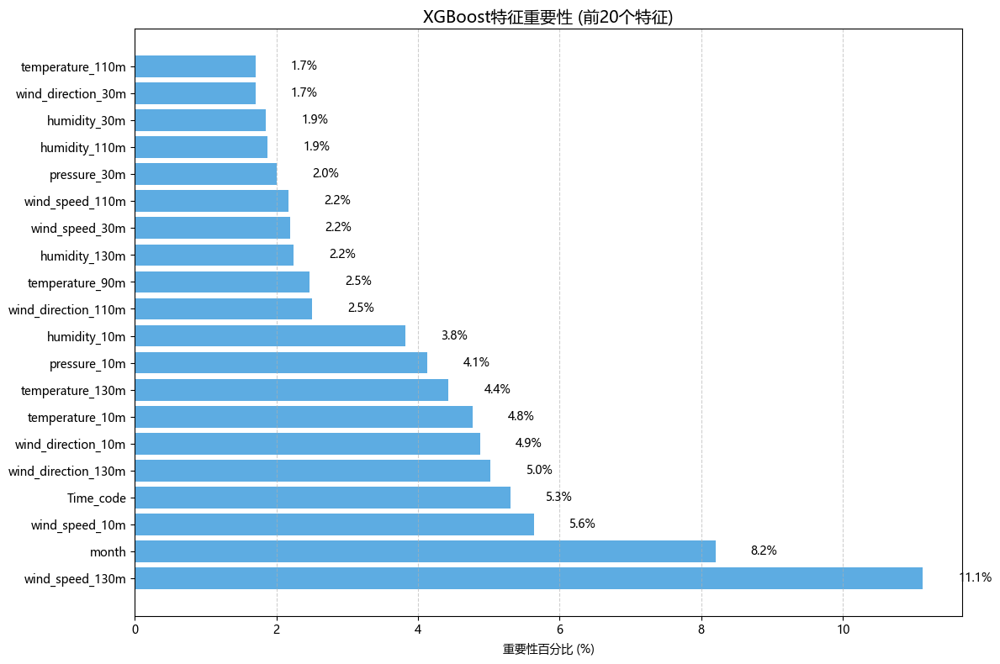

前10个最重要的特征:
1. wind_speed_130m: 11.13%
2. month: 8.20%
3. wind_speed_10m: 5.64%
4. Time_code: 5.30%
5. wind_direction_130m: 5.03%
6. wind_direction_10m: 4.88%
7. temperature_10m: 4.77%
8. temperature_130m: 4.43%
9. pressure_10m: 4.14%
10. humidity_10m: 3.82%


In [42]:
best_model  = model
# 获取特征重要性
importance = best_model.get_booster().get_score(importance_type='weight')

# 将特征重要性转换为百分比并排序
total_importance = sum(importance.values())
importance_percent = {k: (v / total_importance) * 100 for k, v in importance.items()}
importance_sorted = dict(sorted(importance_percent.items(), key=lambda item: item[1], reverse=True))

# 创建一个更美观的特征重要性图
plt.figure(figsize=(12, 8))
features = list(importance_sorted.keys())[:20]  # 取前20个特征
values = [importance_sorted[feature] for feature in features]

# 创建水平条形图
bars = plt.barh(range(len(features)), values, align='center', color='#3498db', alpha=0.8)
plt.yticks(range(len(features)), features)
plt.xlabel('重要性百分比 (%)')
plt.title('XGBoost特征重要性 (前20个特征)', fontsize=14)
plt.grid(axis='x', linestyle='--', alpha=0.6)

# 在条形上添加百分比标签
for i, bar in enumerate(bars):
    plt.text(bar.get_width() + 0.5, bar.get_y() + bar.get_height()/2, 
             f'{values[i]:.1f}%', va='center', fontsize=10)

plt.tight_layout()
plt.show()

# 保存特征重要性数据到CSV文件
importance_df = pd.DataFrame({
    '特征': list(importance_sorted.keys()),
    '重要性(%)': list(importance_sorted.values())
})
importance_df.to_csv('feature_importance.csv', index=False, encoding='utf-8-sig')

# 打印前10个最重要的特征
print("前10个最重要的特征:")
for i, (feature, value) in enumerate(list(importance_sorted.items())[:10]):
    print(f"{i+1}. {feature}: {value:.2f}%")

## 对比评估

月份 2023-09 的数据已存在，跳过追加


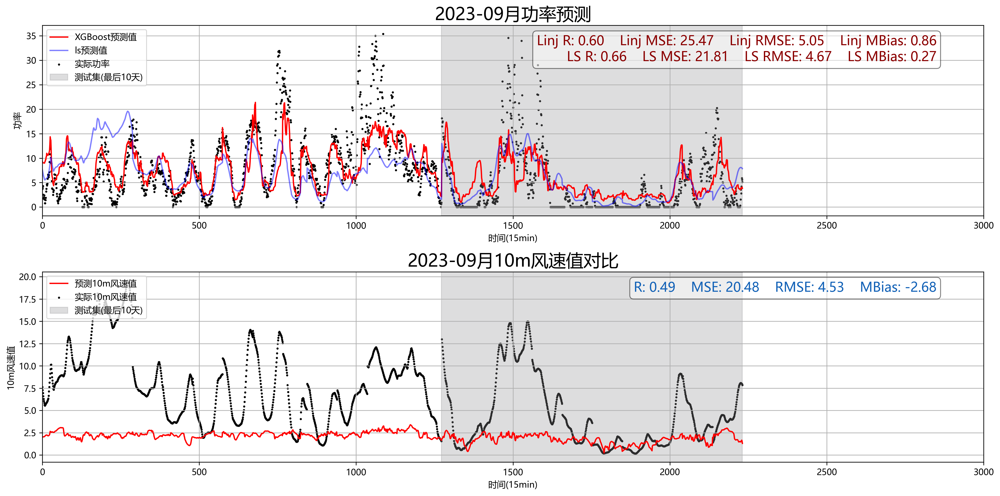

月份 2023-10 的数据已存在，跳过追加


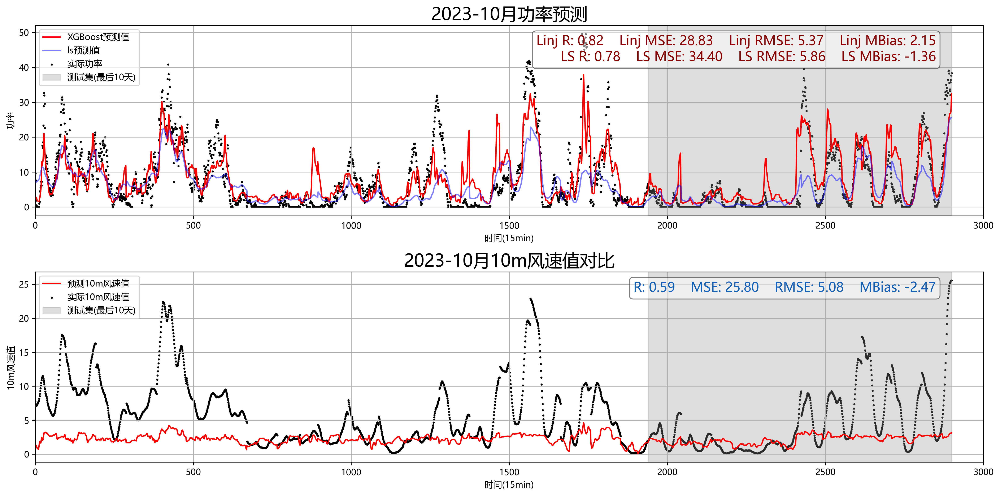

月份 2023-11 的数据已存在，跳过追加


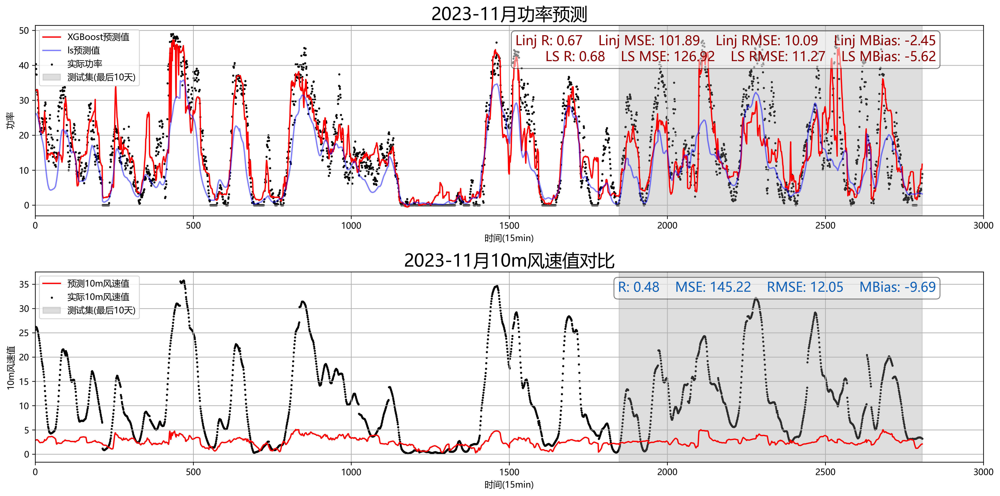

月份 2023-12 的数据已存在，跳过追加


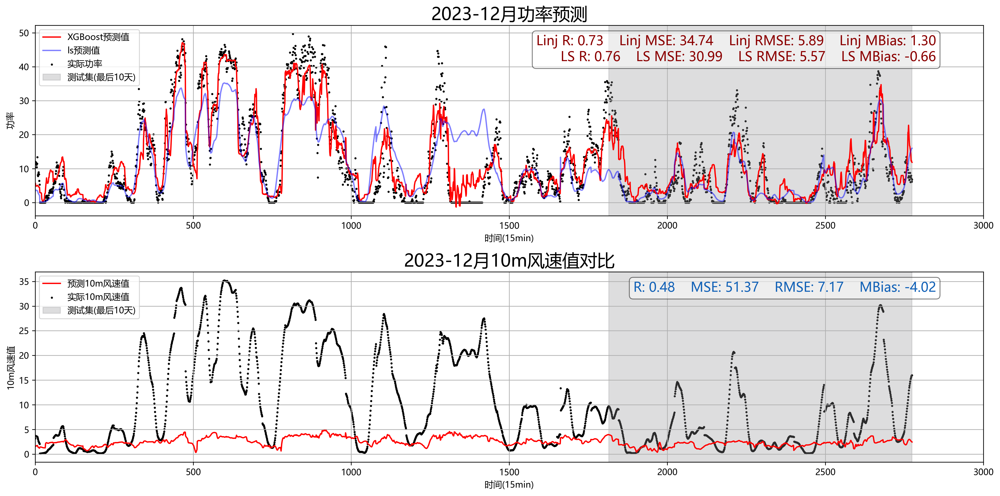

月份 2024-01 的数据已存在，跳过追加


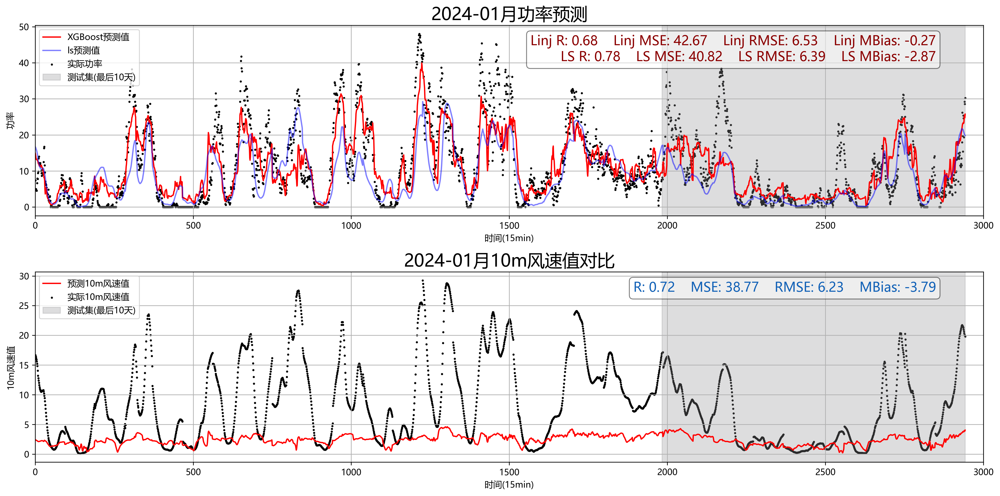

月份 2024-03 的数据已存在，跳过追加


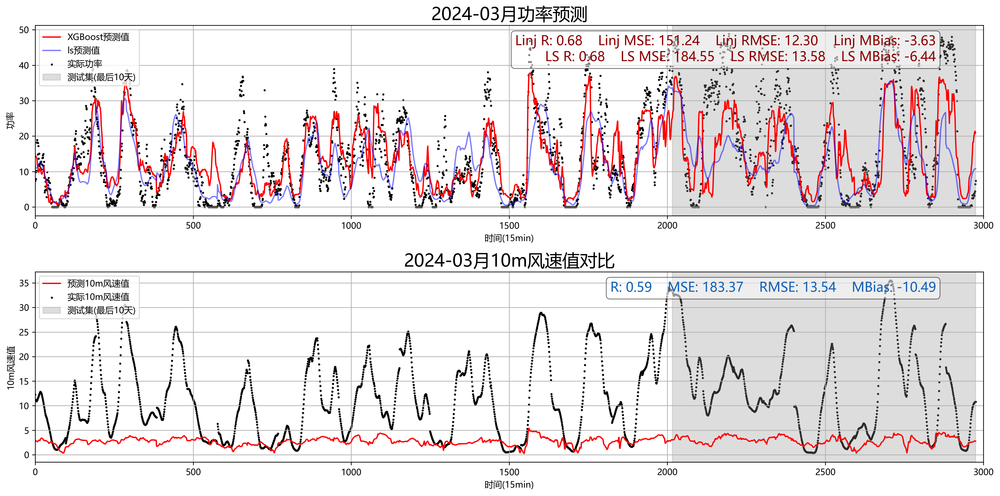

月份 2024-04 的数据已存在，跳过追加


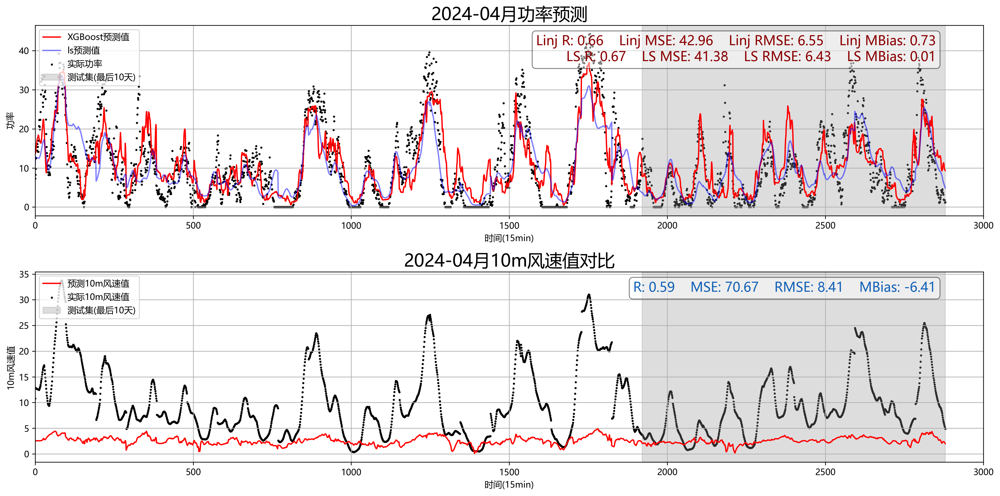

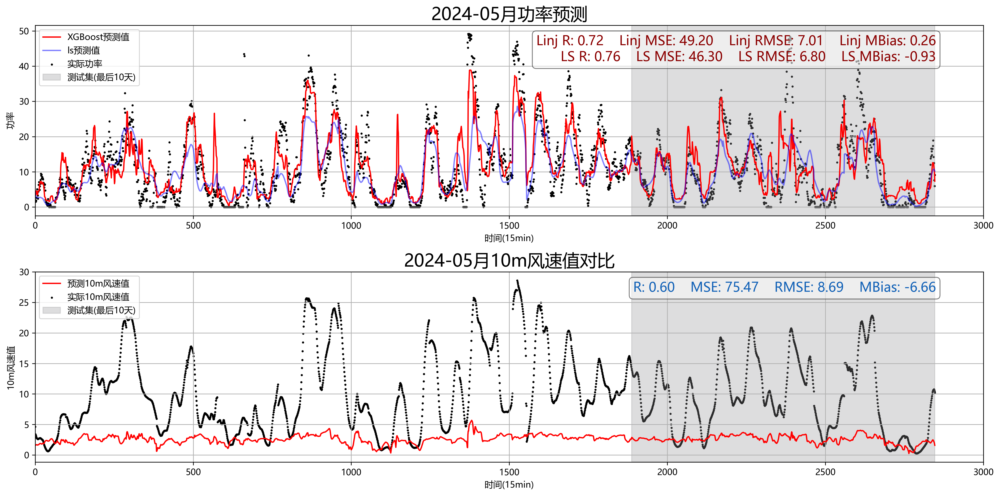

月份 2024-06 的数据已存在，跳过追加


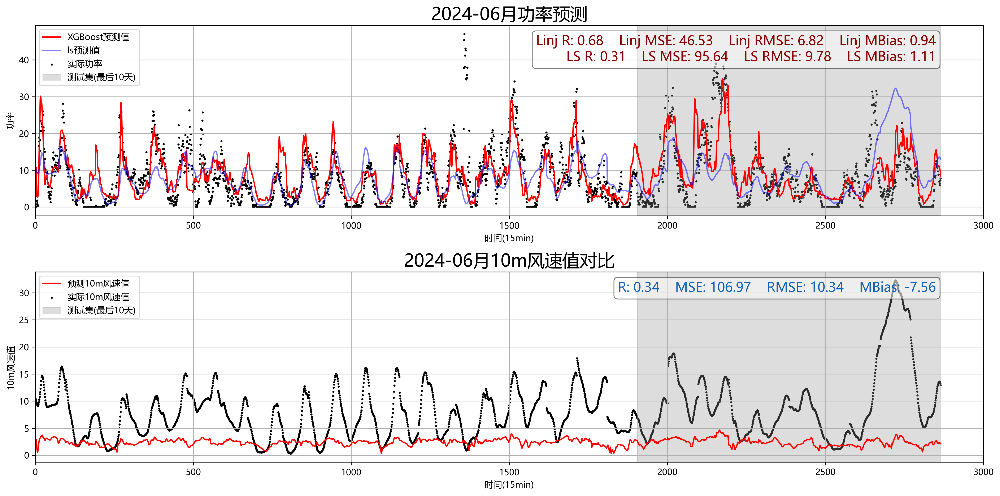

月份 2024-07 的数据已存在，跳过追加


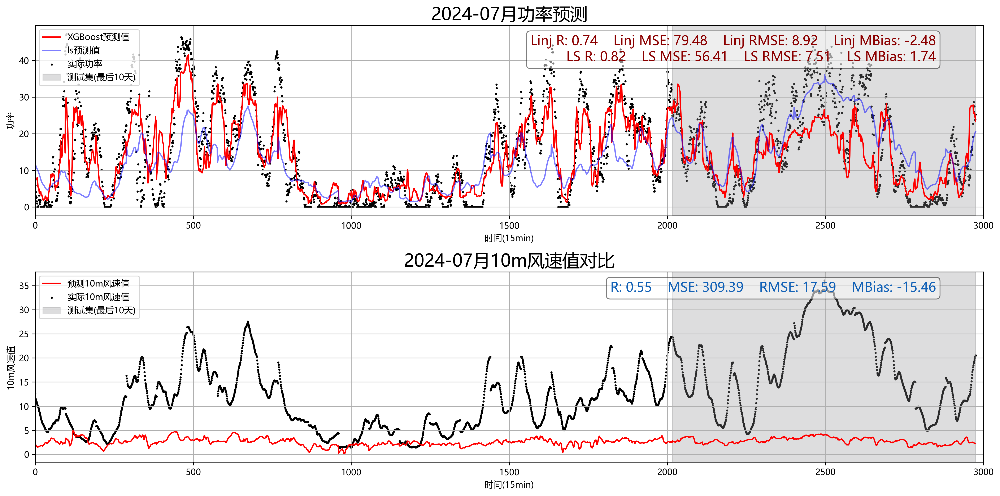

月份 2024-08 的数据已存在，跳过追加


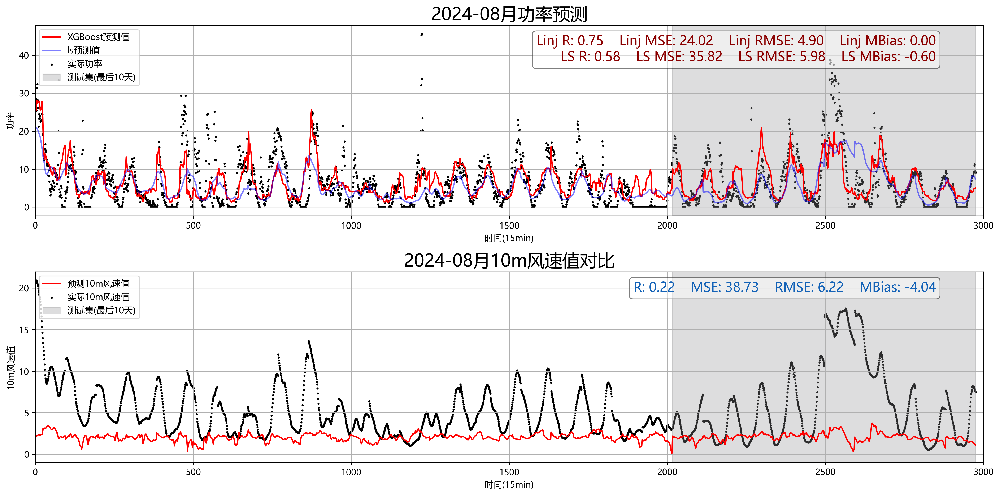

月份 2024-09 的数据已存在，跳过追加


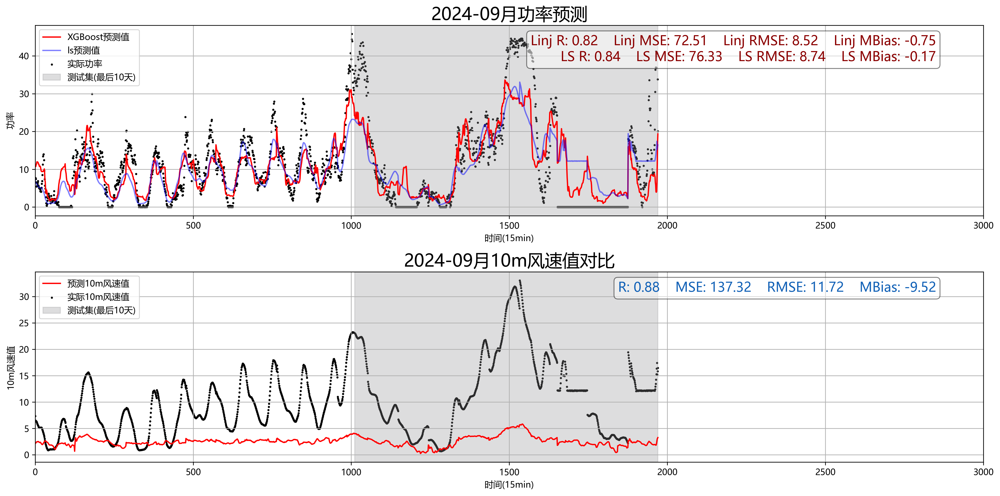

月份 2024-10 的数据已存在，跳过追加


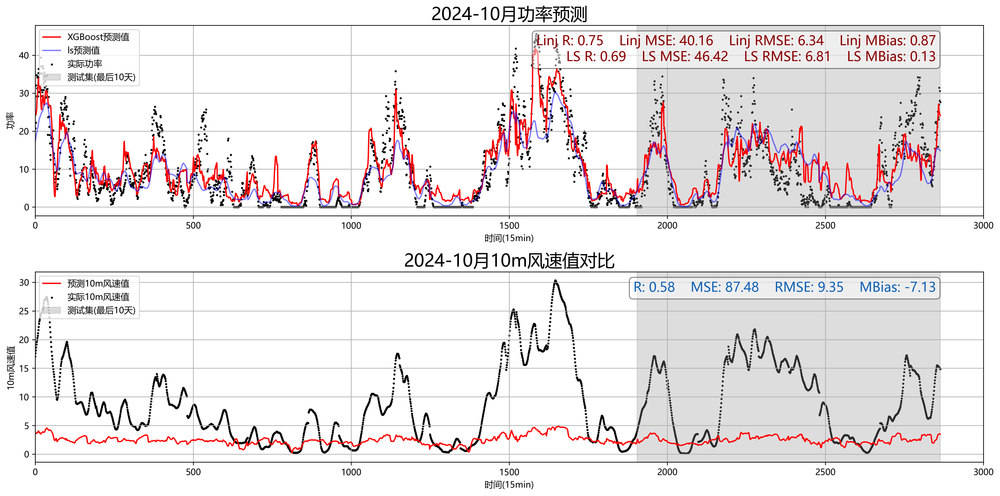

月份 2024-11 的数据已存在，跳过追加


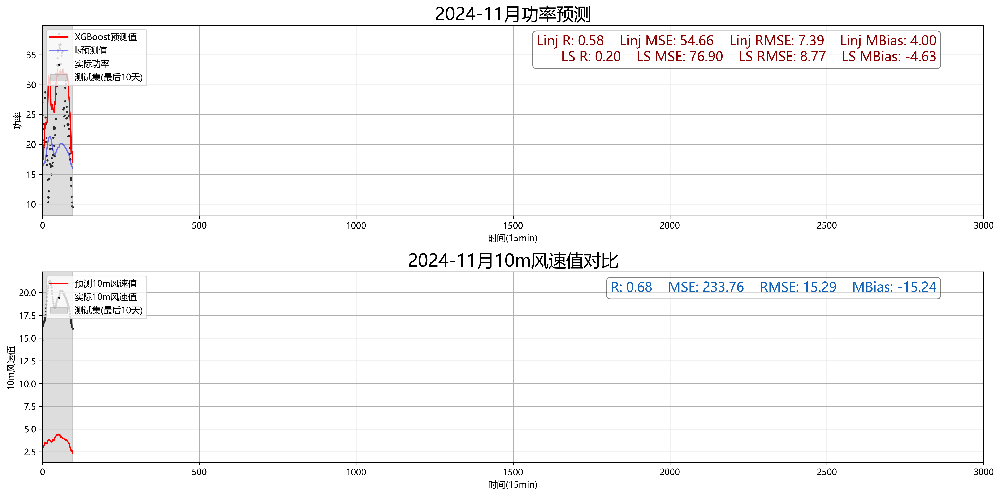

In [43]:
for month, group in year_month_groups:
                
        train_sets = []
        test_sets = []

        last_ten_days = group.iloc[-960:].dropna()
        test_sets.append(last_ten_days)
        train_sets.append(group.iloc[:-960].dropna())

        # 合并当前文件的所有月的最后五天数据
        test_sets_A1 = pd.concat(test_sets)
        train_sets_A1= pd.concat(train_sets)


        X_train1 = train_sets_A1.loc[:,['wind_speed_10m', 'wind_direction_10m', 'temperature_10m',
                'humidity_10m', 'pressure_10m', 'wind_speed_30m', 'wind_direction_30m',
                'temperature_30m', 'humidity_30m', 'pressure_30m', 'wind_speed_50m',
                'wind_direction_50m', 'temperature_50m', 'humidity_50m', 'pressure_50m',
                'wind_speed_70m', 'wind_direction_70m', 'temperature_70m',
                'humidity_70m', 'pressure_70m', 'wind_speed_90m', 'wind_direction_90m',
                'temperature_90m', 'humidity_90m', 'pressure_90m', 'wind_speed_110m',
                'wind_direction_110m', 'temperature_110m', 'humidity_110m',
                'pressure_110m', 'wind_speed_130m', 'wind_direction_130m',
                'temperature_130m', 'humidity_130m', 'pressure_130m','month', 'Time_code']]
        y_train1  = train_sets_A1.loc[:, ['power']]
        X_test1 = test_sets_A1.loc[:,['wind_speed_10m', 'wind_direction_10m', 'temperature_10m',
                'humidity_10m', 'pressure_10m', 'wind_speed_30m', 'wind_direction_30m',
                'temperature_30m', 'humidity_30m', 'pressure_30m', 'wind_speed_50m',
                'wind_direction_50m', 'temperature_50m', 'humidity_50m', 'pressure_50m',
                'wind_speed_70m', 'wind_direction_70m', 'temperature_70m',
                'humidity_70m', 'pressure_70m', 'wind_speed_90m', 'wind_direction_90m',
                'temperature_90m', 'humidity_90m', 'pressure_90m', 'wind_speed_110m',
                'wind_direction_110m', 'temperature_110m', 'humidity_110m',
                'pressure_110m', 'wind_speed_130m', 'wind_direction_130m',
                'temperature_130m', 'humidity_130m', 'pressure_130m','month', 'Time_code']]
        y_test1 = test_sets_A1.loc[:, ['power']]


        X_train1, y_train1, X_test1, y_test1

        wind_speed_10m_train = train_sets_A1.loc[:,['wind_speed_10m']]
        wind_speed_10m_test = test_sets_A1.loc[:,['wind_speed_10m']]

        ls_sw_train = train_sets_A1.loc[:,['power_ls']]
        ls_sw_test = test_sets_A1.loc[:,['power_ls']]

        X = pd.concat([X_train1,X_test1])
        y = pd.concat([y_train1,y_test1]).values.flatten()

        wind_speed_10m = pd.concat([wind_speed_10m_train,wind_speed_10m_test]).values.flatten()
        ls_sw = pd.concat([ls_sw_train,ls_sw_test]).values.flatten()

        # 创建一个包含两个子图的图表
        fig, axes = plt.subplots(2, 1, figsize=(16, 8), dpi=300)
        d_train = X
        # 第一个子图：XGBoost模型预测结果
        axes[0].plot(range(len(X.index.tolist())), model.predict(d_train), color='red', label='XGBoost预测值')
        axes[0].plot(range(len(X.index.tolist())), ls_sw, color='blue', alpha=0.5, label='ls预测值')
        axes[0].scatter(range(len(X.index.tolist())), y, color='black', marker='o', s=2.0, label='实际功率')
        axes[0].grid(True)
        axes[0].set_title(f'{str(month)}月功率预测', fontsize=20)
        axes[0].set_xlabel('时间(15min)')
        axes[0].set_ylabel('功率')
        axes[0].set_xlim(0, 3000)
        predict = model.predict(d_train)
        # 计算第一个子图的评估指标
        mse = mean_squared_error(predict[-960:], y[-960:]) 
        mse_ls = mean_squared_error(ls_sw[-960:], y[-960:]) 
        rmse = np.sqrt(mean_squared_error(predict[-960:], y[-960:])) 
        rmse_ls = np.sqrt(mean_squared_error(ls_sw[-960:], y[-960:])) 
        r = pearson_correlation_coefficient(predict[-960:], y[-960:]) 
        r_ls = pearson_correlation_coefficient(ls_sw[-960:], y[-960:])
        mbias = np.sum(predict[-960:] - y[-960:])/len(y[-960:]) 
        mbias_ls = np.sum(ls_sw[-960:] - y[-960:])/len(y[-960:]) 
        # 创建评估指标数据字典 
        metrics_data = { 
                'Month': [month], 
                'Linj_MSE': [mse], 
                'LS_MSE': [mse_ls], 
                'Linj_RMSE': [rmse], 
                'LS_RMSE': [rmse_ls], 
                'Linj_R': [r], 
                'LS_R': [r_ls], 
                'Linj_MBias': [mbias], 
                'LS_MBias': [mbias_ls] 
        } 
        # 创建DataFrame并保存到CSV 
        metrics_df = pd.DataFrame(metrics_data) 

       # 检查文件是否存在 
        csv_path = 'site_linj_compare_LS.csv' 
        if os.path.exists(csv_path): 
                # 读取已有的CSV文件 
                existing_df = pd.read_csv(csv_path) 
                # 检查当前月份是否已存在
                current_month = metrics_df['Month'].iloc[0]  # 获取当前月份值
                
                # 确保类型一致进行比较
                existing_months = existing_df['Month'].astype(str).values
                current_month_str = str(current_month)
                
                if current_month_str not in existing_months:
                        # 如果月份不存在，则追加数据 
                        metrics_df.to_csv(csv_path, mode='a', header=False, index=False) 
                else:
                        print(f"月份 {current_month} 的数据已存在，跳过追加")
        else: 
                # 如果文件不存在，创建新文件 
                metrics_df.to_csv(csv_path, index=False)
        # 在右上角添加指标文本 
        # 生成Linj模型的评估指标文本 
        linj_textstr = '    '.join((f'Linj R: {r:.2f}',f'Linj MSE: {mse:.2f}',f'Linj RMSE: {rmse:.2f}',f'Linj MBias: {mbias:.2f}' )) 
        # 生成ph模型的评估指标文本 
        ls_textstr = '    '.join((f'LS R: {r_ls:.2f}',f'LS MSE: {mse_ls:.2f}',f'LS RMSE: {rmse_ls:.2f}',f'LS MBias: {mbias_ls:.2f}' )) 
        # 合并两行评估指标 
        textstr = linj_textstr + '\n' + ls_textstr
        axes[0].text(0.95, 0.95, textstr, transform=axes[0].transAxes,
                    fontsize=15, verticalalignment='top', horizontalalignment='right', color='darkred',
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))
        
        # 在第一个子图中标记测试集区域
        start_idx = len(X) - 960
        end_idx = len(X)
        axes[0].axvspan(start_idx, end_idx-1, color='#919193', alpha=0.3, label='测试集(最后10天)')
        axes[0].legend(loc='upper left')
        
        # 第二个子图：辐射值对比
        axes[1].plot(range(len(X.index.tolist())), X['wind_speed_10m'], color='red', label='预测10m风速值')
        axes[1].scatter(range(len(X.index.tolist())), ls_sw, color='black', marker='o', s=2.0, label='实际10m风速值')
        axes[1].grid(True)
        axes[1].set_title(f'{str(month)}月10m风速值对比', fontsize=20)
        axes[1].set_xlabel('时间(15min)')
        axes[1].set_ylabel('10m风速值')
        axes[1].set_xlim(0, 3000)
        
        # 计算第二个子图的评估指标
        predict = X['wind_speed_10m']
        mse = mean_squared_error(predict[-960:], ls_sw[-960:])
        rmse = np.sqrt(mean_squared_error(predict[-960:], ls_sw[-960:]))
        r = pearson_correlation_coefficient(predict[-960:], ls_sw[-960:])
        mbias = np.sum(predict[-960:] - ls_sw[-960:]) / len(ls_sw[-960:])
        
        # 在第二个子图右上角添加指标文本
        textstr = '    '.join((f'R: {r:.2f}', f'MSE: {mse:.2f}', f'RMSE: {rmse:.2f}', f'MBias: {mbias:.2f}'))
        axes[1].text(0.95, 0.95, textstr, transform=axes[1].transAxes,
                    fontsize=15, verticalalignment='top', horizontalalignment='right', color='#1362b7',
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))
        
        # 在第二个子图中标记测试集区域
        axes[1].axvspan(start_idx, end_idx-1, color='#919193', alpha=0.3, label='测试集(最后10天)')
        axes[1].legend(loc='upper left')
        
        # 调整子图之间的间距
        plt.tight_layout()
        
        # 保存图表
        save_dir = 'xgb_fig_ls_merge'
        os.makedirs(save_dir, exist_ok=True)
        plt.savefig(os.path.join(save_dir, f"combined_{str(month)}.png"), dpi=300, format='png', bbox_inches='tight', pad_inches=0)
        plt.show()

## 按月对比评估

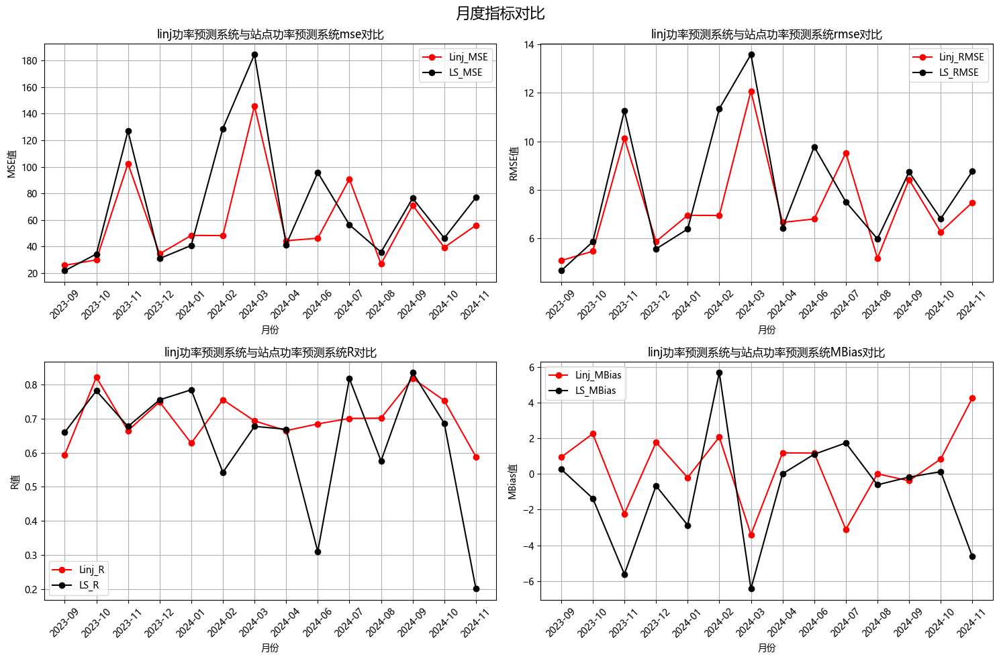

In [78]:
file_path = r'E:\Power_Pre_Model\site_linj_compare_LS.csv'

# 读取数据（假设数据分隔符为空格）
total_df = pd.read_csv(
    file_path,
    header=0,
    low_memory=False,
)

# 创建子图
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
fig.suptitle('月度指标对比', fontsize=16)

# 绘制第一个子图 - mse对比
axes[0,0].plot(total_df['Month'], total_df['Linj_MSE'], marker='o',label='Linj_MSE',color='red')
axes[0,0].plot(total_df['Month'], total_df['LS_MSE'], marker='o',label='LS_MSE',color='black')
axes[0,0].set_title('linj功率预测系统与站点功率预测系统mse对比')
axes[0,0].set_xlabel('月份')
axes[0,0].set_ylabel('MSE值')
axes[0,0].legend()
plt.setp(axes[0,0].get_xticklabels(), rotation=45)

axes[0,0].grid(True)

# 绘制第二个子图 - RMSE对比
axes[0,1].plot(total_df['Month'], total_df['Linj_RMSE'], marker='o',label='Linj_RMSE',color='red')
axes[0,1].plot(total_df['Month'], total_df['LS_RMSE'], marker='o',label='LS_RMSE',color='black')
axes[0,1].set_title('linj功率预测系统与站点功率预测系统rmse对比')
axes[0,1].set_xlabel('月份')
axes[0,1].set_ylabel('RMSE值')
axes[0,1].legend()
plt.setp(axes[0,1].get_xticklabels(), rotation=45)
axes[0,1].grid(True)

# 绘制第三个子图 - R对比
axes[1,0].plot(total_df['Month'], total_df['Linj_R'], marker='o',label='Linj_R',color='red')
axes[1,0].plot(total_df['Month'], total_df['LS_R'], marker='o',label='LS_R',color='black')
axes[1,0].set_title('linj功率预测系统与站点功率预测系统R对比')
axes[1,0].set_xlabel('月份')
axes[1,0].set_ylabel('R值')
axes[1,0].legend()
plt.setp(axes[1,0].get_xticklabels(), rotation=45)
axes[1,0].grid(True)

# 绘制第四个子图 - 预测PR
axes[1,1].plot(total_df['Month'], total_df['Linj_MBias'], marker='o',label='Linj_MBias',color='red')
axes[1,1].plot(total_df['Month'], total_df['LS_MBias'], marker='o',label='LS_MBias',color='black')
axes[1,1].set_title('linj功率预测系统与站点功率预测系统MBias对比')
axes[1,1].set_xlabel('月份')
axes[1,1].set_ylabel('MBias值')
axes[1,1].legend()
plt.setp(axes[1,1].get_xticklabels(), rotation=45)
axes[1,1].grid(True)

# 调整子图布局
plt.tight_layout()

save_dir = 'month_compare_ls'
os.makedirs(save_dir, exist_ok=True)  # 创建保存目录，若不存在则创建
plt.savefig(os.path.join(save_dir, f"month_compare_ls.png"), dpi=500, format='png', bbox_inches='tight', pad_inches=0)
plt.show()
